In [6]:
%pip install pandas
import pandas as pd

file_path = r"C:\Users\Omistaja\Desktop\Quality-of-healthcare-in-Finland-project\data\Continuity of care in Finland.csv"

# Задаём имена колонок вручную (на основе структуры)
columns = [
    "Indicator",        # Название показателя
    "Indicator_ID",     # ID показателя
    "Region",           # Регион ("Whole country" и т.д.)
    "Region_Code",      # Код региона
    "Gender",           # Пол (male/female)
    "Year",             # Год
    "Value",            # Значение показателя
    "Unit"              # Единица измерения (если есть)
]

# Загружаем данные, пропуская первую строку
data = pd.read_csv(file_path, sep=';', encoding='utf-8', names=columns, skiprows=1, engine='python')

# Проверим структуру
print(data.head())
print("\nНазвания столбцов:")
print(data.columns)
print("\nРазмер таблицы:", data.shape)

Note: you may need to restart the kernel to use updated packages.
                                           Indicator  Indicator_ID  \
0  Continuity of care (COCI) for those aged 65 or...          5505   
1  Continuity of care (COCI) for those aged 65 or...          5505   
2  Continuity of care (COCI) for those aged 65 or...          5505   
3  Continuity of care (COCI) for those aged 65 or...          5505   
4  Continuity of care (COCI) for those aged 65 or...          5505   

          Region  Region_Code Gender  Year  Value  Unit  
0  Whole country          358   male  2020   0.23   NaN  
1  Whole country          358   male  2021   0.20   NaN  
2  Whole country          358   male  2022   0.19   NaN  
3  Whole country          358   male  2023   0.20   NaN  
4  Whole country          358   male  2024   0.19   NaN  

Названия столбцов:
Index(['Indicator', 'Indicator_ID', 'Region', 'Region_Code', 'Gender', 'Year',
       'Value', 'Unit'],
      dtype='object')

Размер таблицы: (7

In [7]:
import pandas as pd

file_path = r"C:\Users\Omistaja\Desktop\Quality-of-healthcare-in-Finland-project\data\Continuity of care in Finland.csv"

columns = [
    "Indicator", "Indicator_ID", "Region", "Region_Code",
    "Gender", "Year", "Value", "Unit"
]

data = pd.read_csv(file_path, sep=';', encoding='utf-8', names=columns, skiprows=1, engine='python')

# Удаляем полностью пустые строки
data = data.dropna(how='all')

# Выводим короткий обзор
print("📊 ПЕРВЫЕ 5 СТРОК:\n", data.head(), "\n")
print("🧾 НАЗВАНИЯ КОЛОНОК:", list(data.columns))
print("📏 РАЗМЕР ТАБЛИЦЫ:", data.shape)
print("\nПропущенные значения по столбцам:\n", data.isna().sum())


📊 ПЕРВЫЕ 5 СТРОК:
                                            Indicator  Indicator_ID  \
0  Continuity of care (COCI) for those aged 65 or...          5505   
1  Continuity of care (COCI) for those aged 65 or...          5505   
2  Continuity of care (COCI) for those aged 65 or...          5505   
3  Continuity of care (COCI) for those aged 65 or...          5505   
4  Continuity of care (COCI) for those aged 65 or...          5505   

          Region  Region_Code Gender  Year  Value  Unit  
0  Whole country          358   male  2020   0.23   NaN  
1  Whole country          358   male  2021   0.20   NaN  
2  Whole country          358   male  2022   0.19   NaN  
3  Whole country          358   male  2023   0.20   NaN  
4  Whole country          358   male  2024   0.19   NaN   

🧾 НАЗВАНИЯ КОЛОНОК: ['Indicator', 'Indicator_ID', 'Region', 'Region_Code', 'Gender', 'Year', 'Value', 'Unit']
📏 РАЗМЕР ТАБЛИЦЫ: (71, 8)

Пропущенные значения по столбцам:
 Indicator        0
Indicator_ID     0


FFmpeg not found, animation saved as GIF: C:\Users\Omistaja\Desktop\Quality-of-healthcare-in-Finland-project\results\Continuity_of_Care_in_Finland_(combined_genders_&_all_regions)_for_outpatients_in_primary_care.gif
Static figure saved as PNG: C:\Users\Omistaja\Desktop\Quality-of-healthcare-in-Finland-project\results\Continuity_of_Care_in_Finland_(combined_genders_&_all_regions)_for_outpatients_in_primary_care.png


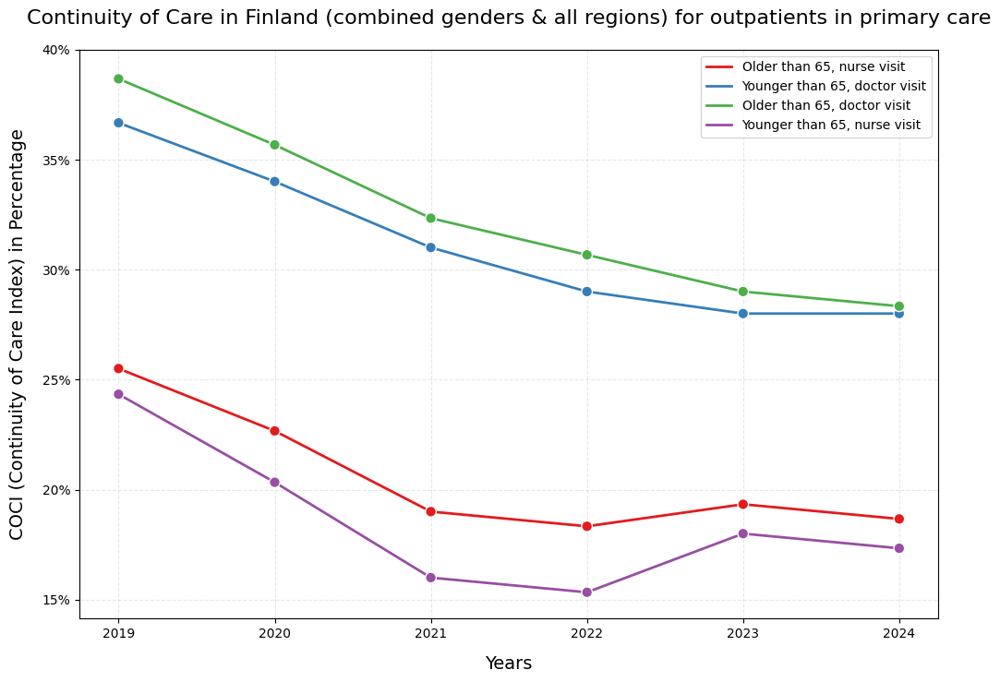

In [17]:
import os
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from matplotlib.animation import FuncAnimation, FFMpegWriter
from scipy.interpolate import interp1d
from IPython.display import HTML

# 🎯 Filter data
df_region = data[data['Region'] == 'Whole country']

# Original indicator names in data
indicators = [
    "Continuity of care (COCI) for those aged 65 or over during outpatient visits (nurse) to primary health care",
    "Continuity of care (COCI) in professional outpatient visits (doctor) in primary health care",
    "Continuity of care (COCI) in professional outpatient visits (doctor) in primary health care for people aged 65 or over",
    "Continuity of care (COCI) in professional outpatient visits (nurse) in primary health care"
]

# ✅ Custom legend names (in same order)
legend_labels = [
    "Older than 65, nurse visit",
    "Younger than 65, doctor visit",
    "Older than 65, doctor visit",
    "Younger than 65, nurse visit"
]

df_region = df_region[df_region['Indicator'].isin(indicators)]
df_combined = df_region.groupby(['Indicator', 'Year'])['Value'].mean().reset_index()

# 🧭 Plot setup
fig, ax = plt.subplots(figsize=(12, 8))
palette = sns.color_palette("Set1", n_colors=len(indicators))
lines, scatters = [], []

for i, ind in enumerate(indicators):
    # ✅ Use human-readable legend label instead of indicator text
    line, = ax.plot([], [], color=palette[i], lw=2, label=legend_labels[i])
    df_i = df_combined[df_combined["Indicator"] == ind]
    sc = ax.scatter(df_i["Year"], df_i["Value"] * 100, color=palette[i], s=70,  # ✅ multiply by 100 for percent
                    edgecolor="white", zorder=5, alpha=0)
    lines.append(line)
    scatters.append(sc)

# ✅ Convert all Y-values to percentages
df_combined["Value"] = df_combined["Value"] * 100

# Axis settings
# ✅ Define Y-axis range and even ticks
y_min = np.floor(df_combined["Value"].min() / 5) * 5
y_max = np.ceil(df_combined["Value"].max() / 5) * 5

# ✅ Even step (e.g., 5% steps) and fewer labels (~6 ticks)
y_ticks = np.linspace(y_min, y_max, 6)
ax.set_yticks(y_ticks)
ax.set_yticklabels([f"{int(y)}%" for y in y_ticks])


# ✅ Format Y-axis labels as integer percentages
ax.set_yticklabels([f"{int(y)}%" for y in ax.get_yticks()])

# ✅ Updated title and axis label with extra spacing
ax.set_title(
    "Continuity of Care in Finland (combined genders & all regions) for outpatients in primary care",
    fontsize=16,
    pad=20  # ✅ add extra space above the plot
)
# Add some space between the axis labels and the axes
ax.set_xlabel("Years", fontsize=14, labelpad=12)   # increase labelpad to move X-axis label down
ax.set_ylabel("COCI (Continuity of Care Index) in Percentage", fontsize=14, labelpad=12)  # move Y-axis label left


# ✅ Legend now uses your custom labels
ax.legend(loc="upper right", fontsize=10)
ax.grid(True, linestyle="--", alpha=0.3)
ax.set_xticks(sorted(df_combined["Year"].unique()))

# 🚀 Interpolation
interp_data = []
year_data = []
n_points = 20
for ind in indicators:
    df_plot = df_combined[df_combined["Indicator"] == ind]
    f = interp1d(df_plot["Year"], df_plot["Value"], kind="linear")
    xnew = np.linspace(df_plot["Year"].min(), df_plot["Year"].max(), (len(df_plot) - 1) * n_points + 1)
    ynew = f(xnew)
    interp_data.append((xnew, ynew))
    year_data.append((df_plot["Year"].values, df_plot["Value"].values))

# -----------------------------
# Animation settings
# -----------------------------
pause_seconds = 5
interval_ms = 80
extra_frames = int(pause_seconds * 1000 / interval_ms)
max_data_frames = len(interp_data[0][0])
total_frames = max_data_frames + extra_frames

title_str = ax.get_title()
safe_title = title_str.replace(" ", "_")

# Output folder
results_dir = r"C:\Users\Omistaja\Desktop\Quality-of-healthcare-in-Finland-project\results"
os.makedirs(results_dir, exist_ok=True)

mp4_path = os.path.join(results_dir, f"{safe_title}.mp4")
gif_path = os.path.join(results_dir, f"{safe_title}.gif")
png_path = os.path.join(results_dir, f"{safe_title}.png")

# -----------------------------
# Update function for animation
# -----------------------------
def update(frame):
    frame_idx = min(frame, max_data_frames)
    for i, (line, sc) in enumerate(zip(lines, scatters)):
        xnew, ynew = interp_data[i]
        line.set_data(xnew[:frame_idx], ynew[:frame_idx])  # already in %
        x_years, y_years = year_data[i]
        alphas = np.zeros_like(x_years, dtype=float)
        for j, x_val in enumerate(x_years):
            if x_val <= xnew[frame_idx - 1]:
                alphas[j] = 1.0
            else:
                alphas[j] = 0.0
        sc.set_alpha(None)
        sc.set_facecolors([[*palette[i], a] for a in alphas])
    return lines + scatters

# -----------------------------
# Animation creation
# -----------------------------
ani = FuncAnimation(fig, update, frames=total_frames, interval=interval_ms, blit=True)

# -----------------------------
# Save animation
# -----------------------------
try:
    writer = FFMpegWriter(fps=12, metadata=dict(artist='Me'), bitrate=1800)
    ani.save(mp4_path, writer=writer, dpi=150)
    print(f"Animation saved as MP4: {mp4_path}")
except FileNotFoundError:
    ani.save(gif_path, writer='pillow', fps=12)
    print(f"FFmpeg not found, animation saved as GIF: {gif_path}")

# -----------------------------
# Save static figure
# -----------------------------
fig.savefig(png_path, dpi=150)
print(f"Static figure saved as PNG: {png_path}")

# 🎬 Display animation in Jupyter
HTML(ani.to_jshtml())

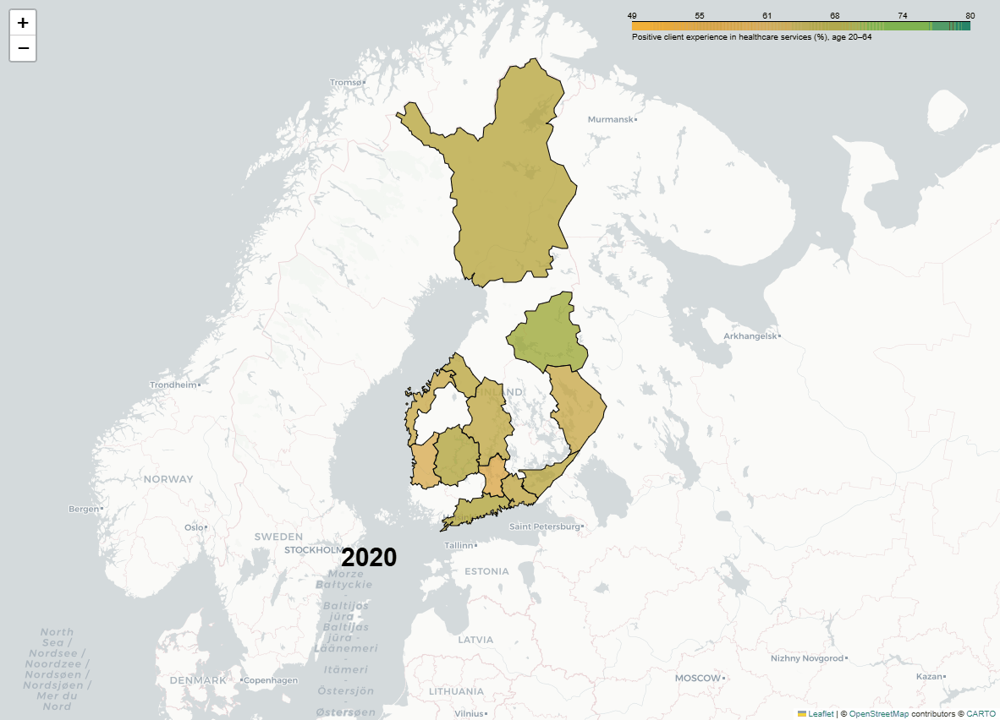

✅GIF animation created with dynamic gradient range.


In [33]:
import folium
import pandas as pd
import geopandas as gpd
import branca
from selenium import webdriver
from selenium.webdriver.chrome.options import Options
from PIL import Image
import time
import os
from IPython.display import Image as IPyImage, display

# --- Load data ---
finland_map = gpd.read_file(r"C:\Users\Omistaja\Desktop\Quality-of-healthcare-in-Finland-project\data\fi.json")
data = pd.read_csv(
    r"C:\Users\Omistaja\Desktop\Quality-of-healthcare-in-Finland-project\data\Positive client experience in Finland.csv",
    sep=';', header=None
)
data.columns = ['metric', 'code', 'region_name', 'unknown1', 'unknown2', 'year', 'value', 'unknown3']
data['value'] = pd.to_numeric(data['value'], errors='coerce')
data = data.dropna(subset=['value'])

# --- Define years for the animation ---
years = sorted(data['year'].unique())

# --- Setup Selenium ---
chrome_options = Options()
chrome_options.add_argument("--headless")
chrome_options.add_argument("--window-size=1200,1000")
driver = webdriver.Chrome(options=chrome_options)

frames = []

# --- Dynamic range for the gradient across all data ---
vmin, vmax = data['value'].min(), data['value'].max()
colormap = branca.colormap.LinearColormap(
    colors=['#FFA500',"#DB931E", "#D3A23E", "#A39821", "#65B11E", '#006400'],  # orange → yellow → light green → dark green
    vmin=vmin,
    vmax=vmax
)
colormap.caption = 'Positive client experience in healthcare services (%), age 20–64'

# --- Generate map and screenshots for each year ---
for year in years:
    m = folium.Map(location=[64, 26], zoom_start=5, tiles='cartodbpositron')
    colormap.add_to(m)

    year_data = data[data['year'] == year]
    features = []

    for idx, row in finland_map.iterrows():
        region_name = row['name']
        region_geom = row['geometry'].__geo_interface__
        val_row = year_data[year_data['region_name'] == region_name]
        if not val_row.empty:
            value = val_row['value'].values[0]
            features.append({
                'type': 'Feature',
                'geometry': region_geom,
                'properties': {
                    'style': {
                        'fillColor': colormap(value),
                        'color': 'black',
                        'weight': 1,
                        'fillOpacity': 0.7,
                    },
                    'tooltip': f"{region_name}: {value:.1f}% ({year})"
                }
            })

    folium.GeoJson({'type': 'FeatureCollection', 'features': features}).add_to(m)

    # --- Year label on the map ---
    folium.map.Marker(
        [59.5, 18],
        icon=folium.DivIcon(
            html=f'<div style="font-size:30px; color:black; font-weight:bold;">{year}</div>'
        )
    ).add_to(m)

    # --- Temporary HTML for screenshot ---
    tmp_html = f"tmp_map_{year}.html"
    m.save(tmp_html)

    # --- Screenshot via Selenium ---
    driver.get(f"file:///{os.path.abspath(tmp_html)}")
    time.sleep(2)
    png_filename = f"frame_{year}.png"
    driver.save_screenshot(png_filename)
    frames.append(Image.open(png_filename))

    os.remove(tmp_html)

driver.quit()

# --- Create GIF ---
gif_path = r"C:\Users\Omistaja\Desktop\Quality-of-healthcare-in-Finland-project\finland_animation.gif"
frames[0].save(
    gif_path,
    save_all=True,
    append_images=frames[1:],
    duration=1200,
    loop=0
)

# --- Display GIF directly in the notebook ---
display(IPyImage(filename=gif_path))
print("✅GIF animation created with dynamic gradient range.")